# Import packages and set style

In [1]:
import glob
import pandas as pd
import numpy as np

import scanpy as sc
import doubletdetection

import matplotlib.pyplot as plt
import seaborn as sns

from utils.utils import *
%matplotlib inline

In [2]:
custom_params = {'axes.spines.right': False, 'axes.spines.top': False,
                 'figure.dpi':300, 'savefig.dpi':300}
sns.set_theme(style='ticks', rc=custom_params)
sns.set_style({'axes.grid' : False})

# User supplied paths

In [3]:
results_directory = '../data/'
cellranger = True

In [4]:
# CellRanger
if cellranger:
    path_files = glob.glob(results_directory + '*h5')
    
# SEQC
else:
    path_files = glob.glob(results_directory + '*csv')
    
path_files.sort()
path_files

['../data/5k_pbmc_protein_v3_filtered_feature_bc_matrix.h5',
 '../data/5k_pbmc_protein_v3_nextgem_filtered_feature_bc_matrix.h5']

In [5]:
# Dictionary of sample_name:'path/to/sample'
samples_d = {}

samples_d['v3'] = path_files[0]
samples_d['nextgem'] = path_files[1]

sample_names = list(samples_d)
num_samples = len(sample_names)

sample_names.sort()
sample_names

['nextgem', 'v3']

In [6]:
combined_sample_color = 'g'
sample_palette = sns.color_palette('colorblind', len(sample_names))

# Dictionary of sample_name:color
sample_palette_d = {}
for i, sample in enumerate(sample_names):
    sample_palette_d[sample] = sample_palette[i]

sample_palette

[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549)]

# Generate adata

In [7]:
# Dictionary of sample_name:adata
adata_d = {}

# SEQC
if not cellranger:
    for sample in sample_names:
        print(sample)
        path = samples_d[sample]
        adata_d[sample] = read_in_dense(path, sample)

# CellRanger
else:
    for sample in sample_names:
        print(sample)
        path = samples_d[sample]
        adata_d[sample] = sc.read_10x_h5(path, gex_only=True)
        adata_d[sample].obs['Sample'] = sample
        adata_d[sample].var_names_make_unique()

nextgem


/Users/sohailn/miniconda3/envs/std_v3/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


v3


In [8]:
# Pooling together the samples
adata = sc.AnnData.concatenate(
    *list(adata_d.values()), # the asterisk unpacks the list containing your AnnData objects. 
    join='outer', 
    batch_key = 'Sample', 
    batch_categories = sample_names,
    # Make sure the order of the batch categories matches that of the AnnData objects 
    index_unique = '_'
)

num_cells = adata.shape[0]
num_genes = adata.shape[1]

print('Number of cells:', num_cells)
print('Number of genes:', num_genes)

Number of cells: 10774
Number of genes: 33538


/Users/sohailn/miniconda3/envs/std_v3/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


# Basic QC (before filtration)

## Calculation

In [9]:
adata.layers['raw_counts'] = adata.X

# Calculate QC
adata, mito_genes, ribo_genes = qc_metrics(adata)

adata.obs['log10_total_counts'] = np.log10(adata.obs['total_counts'])
adata

AnnData object with n_obs × n_vars = 10774 × 33538
    obs: 'Sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'log10_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mito', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'raw_counts'

## Number of cells per sample

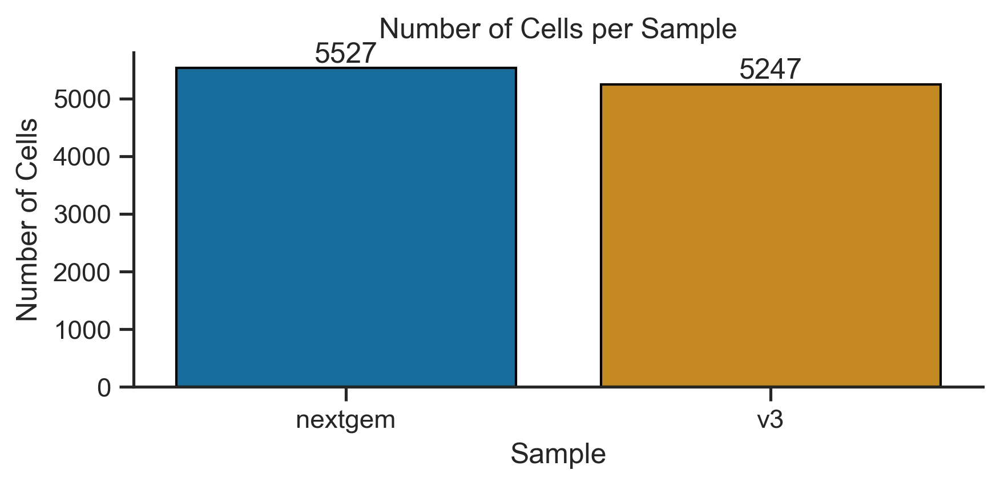

In [10]:
fig, ax = plt.subplots(figsize=(6, 3), dpi=300)
plot_num_cells(adata=adata, 
               obs_col='Sample', 
               ax=ax, 
               palette=sample_palette_d
              )
fig.tight_layout()

## Mitochondrial fraction

### Colored by sample

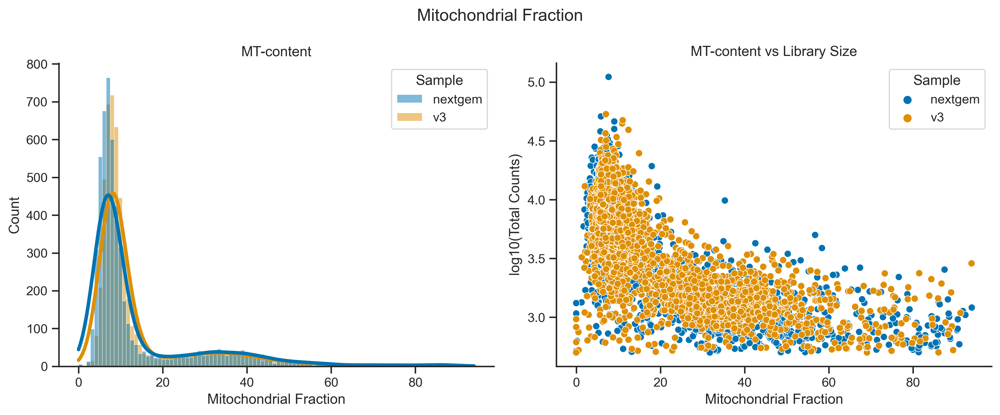

In [11]:
plot_mito_combined(adata, sample_palette_d, sample_names)

### Each sample individually

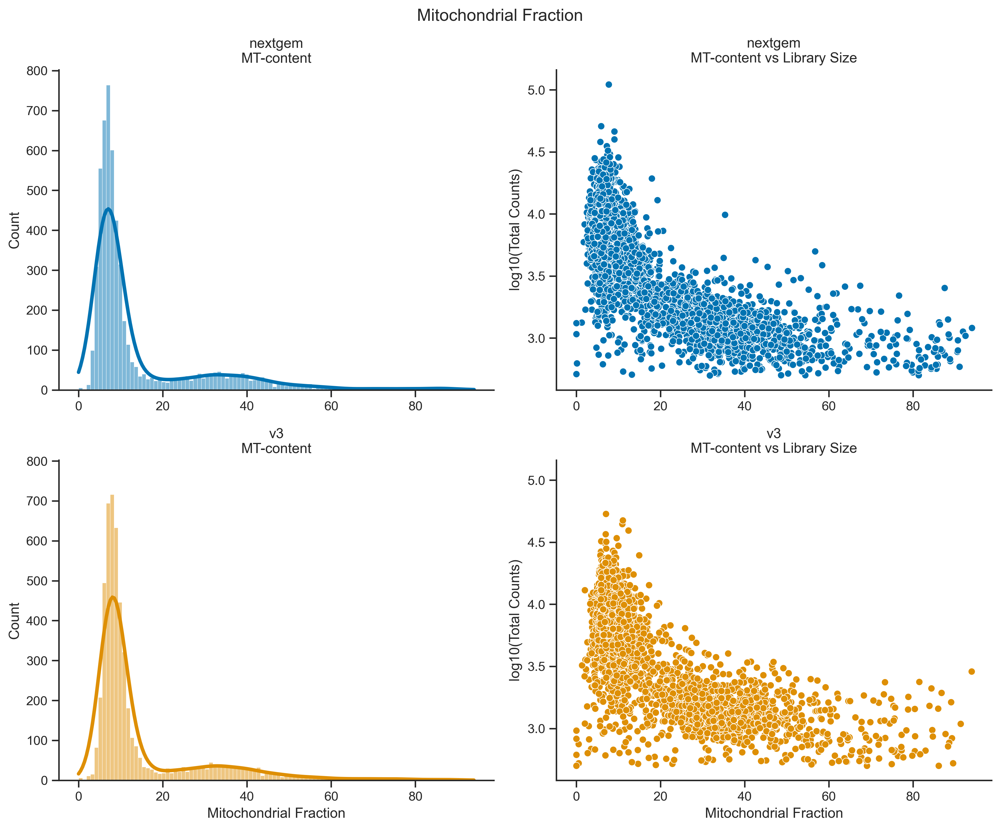

In [12]:
plot_mito_separated(adata, sample_palette_d, sample_names)

## Ribosomal Fraction

### Colored by sample

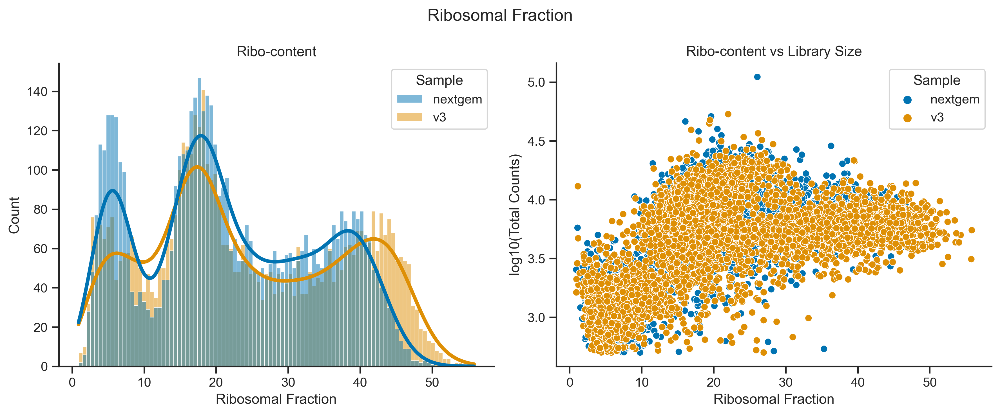

In [13]:
plot_ribo_combined(adata, sample_palette_d, sample_names)

### Each sample individually

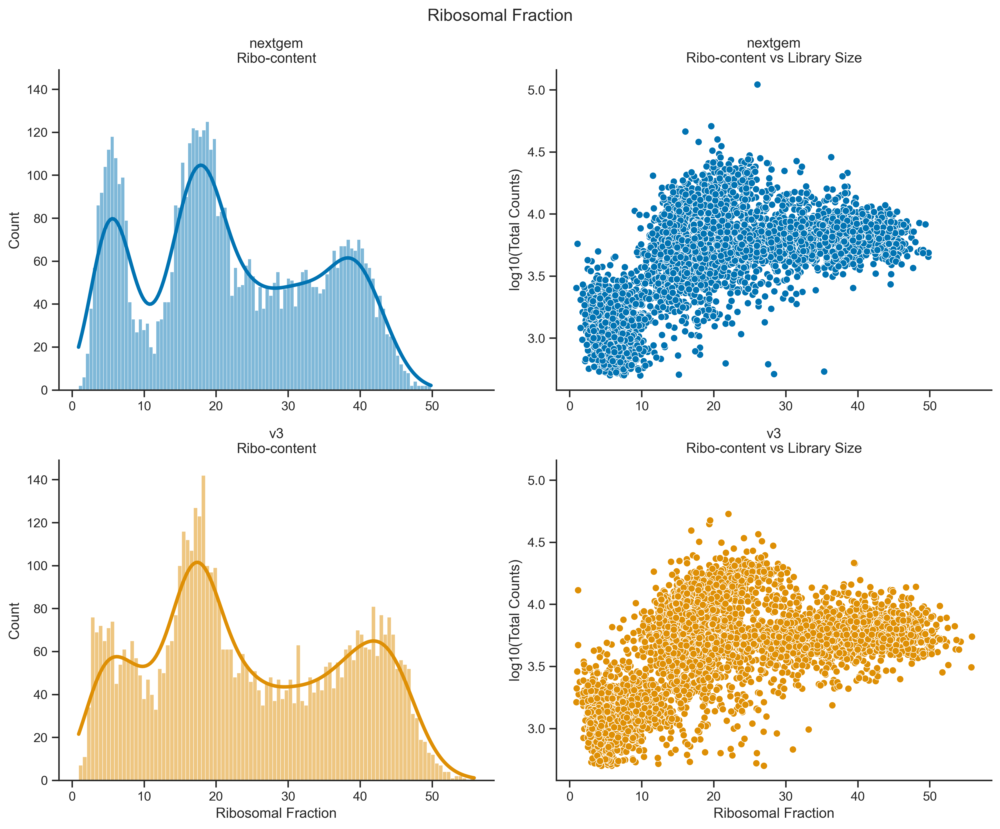

In [14]:
plot_ribo_separated(adata, sample_palette_d, sample_names)

## Cells a gene is expressed in

### Colored by sample

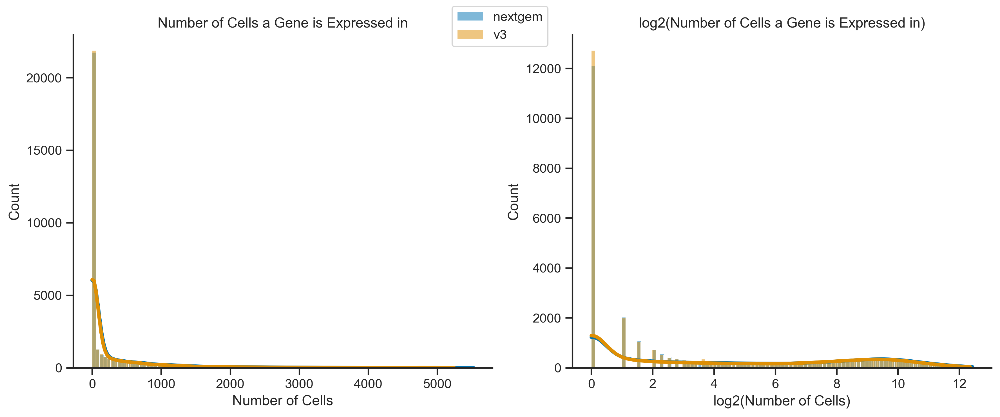

In [15]:
plot_ngenes_combined(adata, sample_palette_d, sample_names)

### Each sample individually

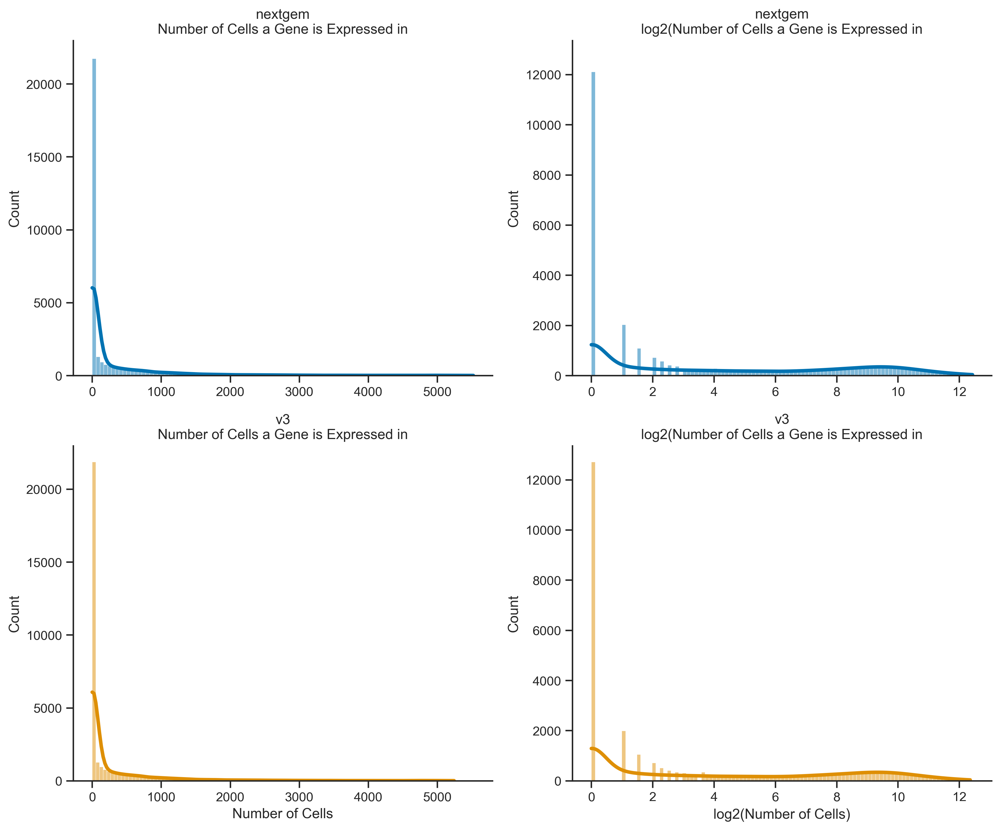

In [16]:
plot_ngenes_separated(adata, sample_palette_d, sample_names)

## Library size

### Colored by sample

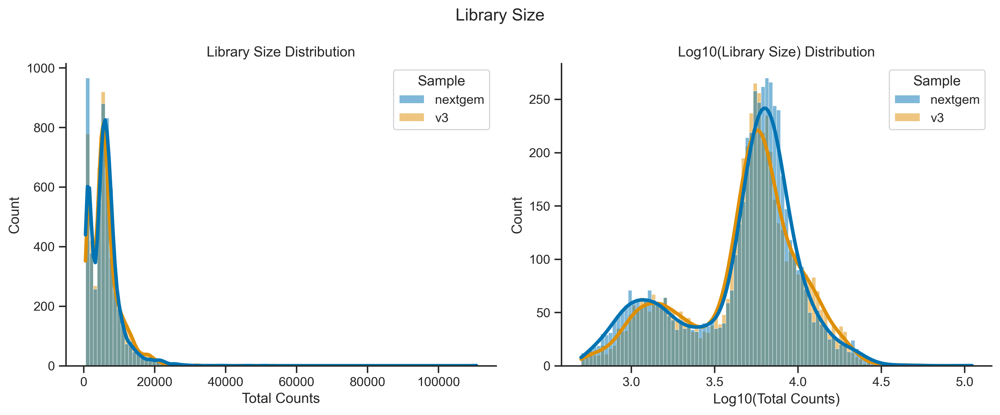

In [17]:
plot_lib_combined(adata, sample_palette_d, sample_names)

### Each sample individually

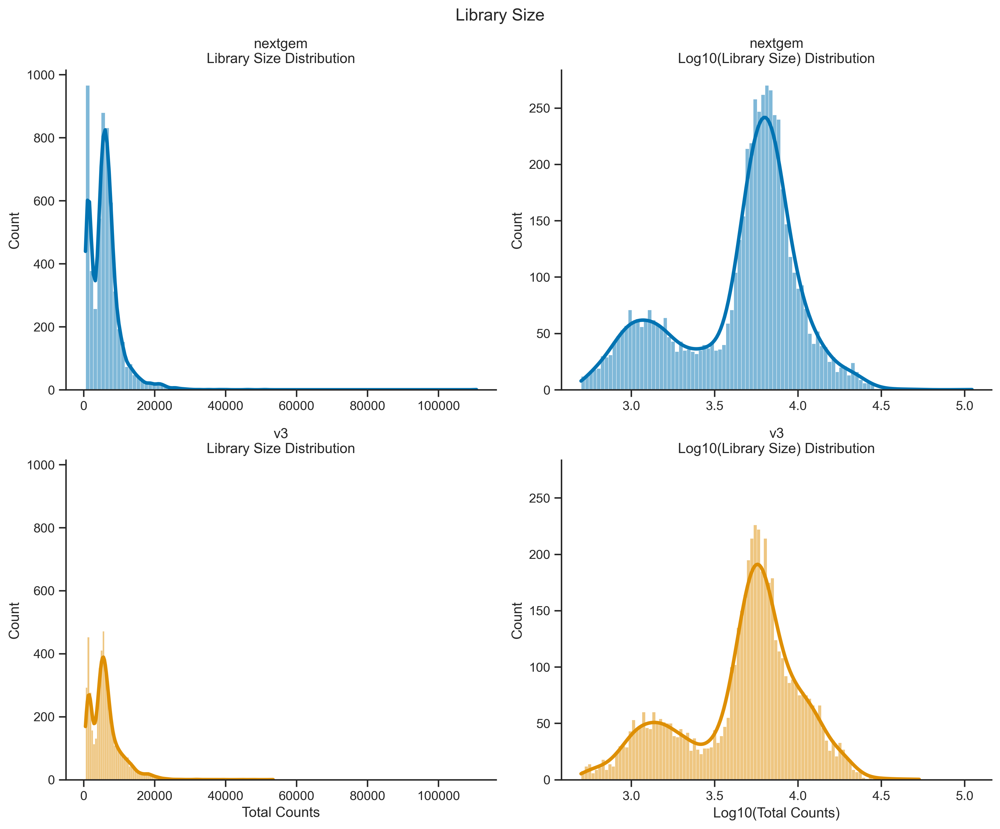

In [18]:
plot_lib_separated(adata, sample_palette_d, sample_names)

# Filter lowly expressed genes

In [19]:
# Remove lowly expressed genes
num_genes = adata.shape[1]
sc.pp.filter_genes(adata, min_counts=10)

print(num_genes - adata.shape[1], 'genes filtered out')
num_genes = adata.shape[1]
print(num_genes, 'genes remaining')

16743 genes filtered out
16795 genes remaining


# Preprocessing

In [20]:
# Shuffle the order of cells
index_list = np.arange(adata.shape[0])
np.random.shuffle(index_list)
adata = adata[index_list,:]

adata = preprocessing(adata)

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 4.037628173828125 seconds
Jaccard graph constructed in 2.6038129329681396 seconds
Wrote graph to binary file in 0.18129324913024902 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.868456
Louvain completed 21 runs in 4.412009000778198 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 12.31141185760498 seconds


In [21]:
num_genes = adata.shape[1]
print(sum(adata.var['highly_variable']), 'highly variable genes')
print(num_genes, 'total genes')

4500 highly variable genes
16795 total genes


## HVGs

Contrasting the expression against the amount of varianced explained by each gene, highlighting the genes that are labelled as highly variable.

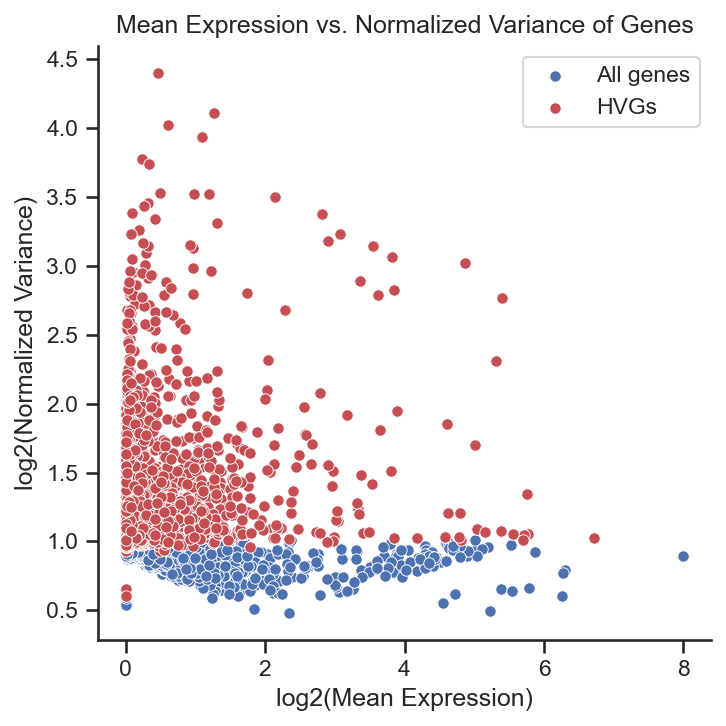

In [22]:
fig, ax = plt.subplots(figsize=(5, 5), dpi=150)
plot_hvgs(adata, ax)
fig.tight_layout()

## PCA

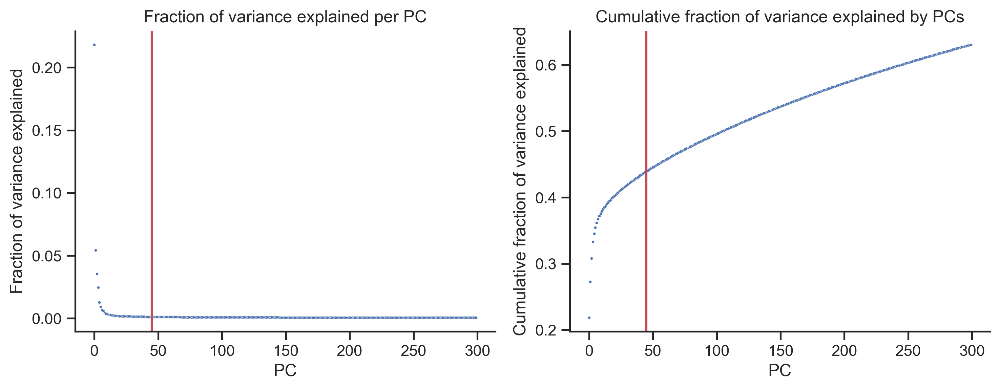

In [23]:
cml_var_explained = pca_plot(adata)

In [24]:
knee = adata.obsm['X_pca'].shape[1]
print('Kneepoint:', knee)
print('Variance explained:', cml_var_explained[knee])

Kneepoint: 45
Variance explained: 0.43939537


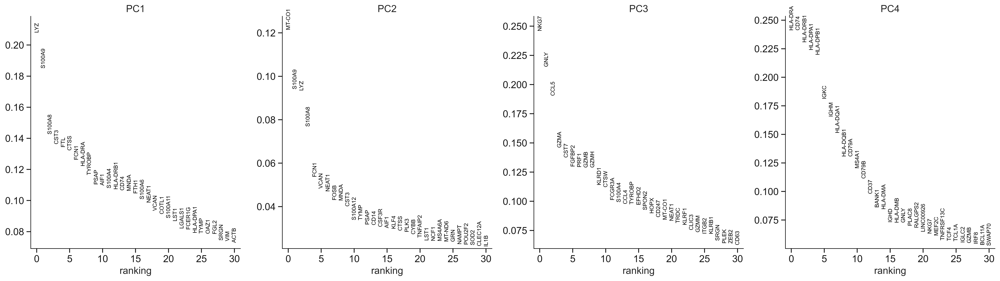

In [25]:
# Style
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=300)
sns.set_style({'axes.grid' : False})

sc.pl.pca_loadings(adata, components = '1, 2, 3, 4', include_lowest=False)

# UMAPs

## Sample

<AxesSubplot:title={'center':'Sample'}, xlabel='UMAP1', ylabel='UMAP2'>

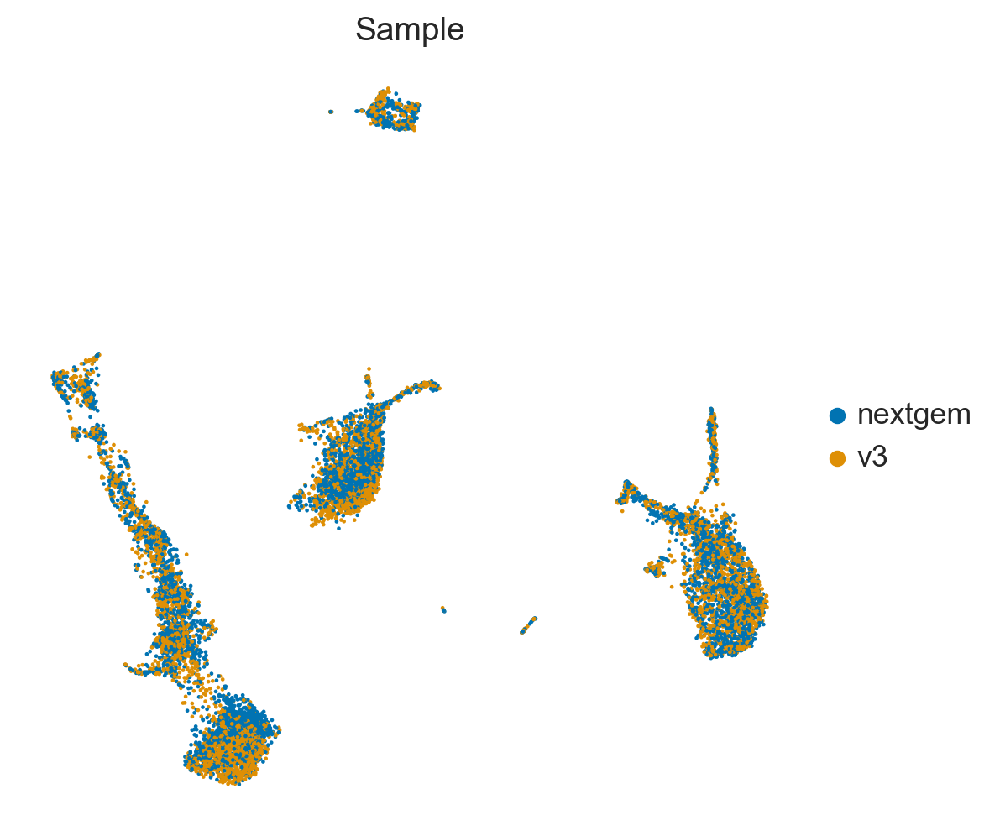

In [26]:
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=100)
sc.pl.umap(
    adata, 
    color=['Sample'],
    title = 'Sample',
    cmap='viridis', 
    frameon=False,
    show=False,
    palette=sample_palette_d,
)


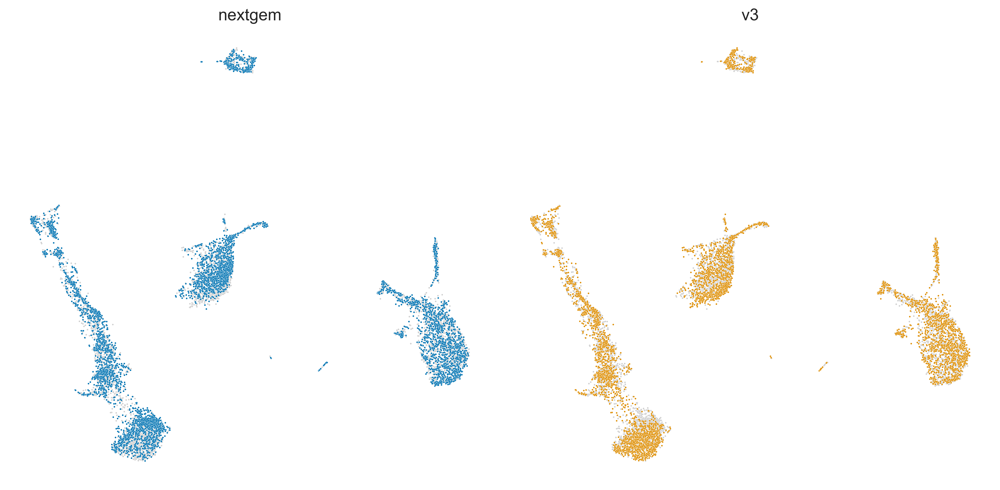

In [27]:
sns.set_style({'axes.grid' : False})
fig, axes = plt.subplots(1, num_samples, 
                         figsize=(6 * num_samples, 6), 
                         dpi=300)
plot_umap_subset(adata=adata, 
                 obs_col='Sample', 
                 axes=axes, 
                 palette=sample_palette_d)
fig.tight_layout()

## Library size

<AxesSubplot:title={'center':'Log10(Total Counts)'}, xlabel='UMAP1', ylabel='UMAP2'>

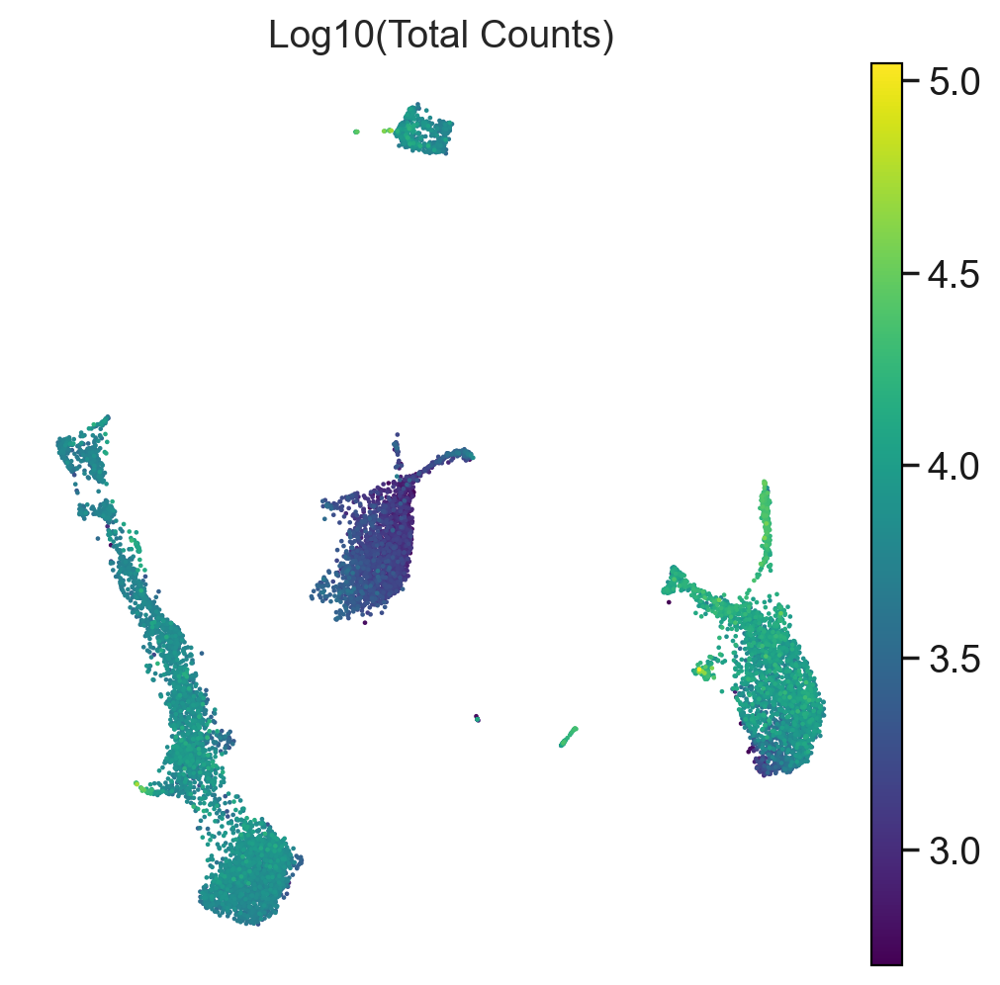

In [28]:
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=100)
sc.pl.umap(
    adata, 
    color=['log10_total_counts'],
    title = 'Log10(Total Counts)',
    show=False,
    cmap='viridis', 
    frameon=False,
)

## Mito and ribo fraction

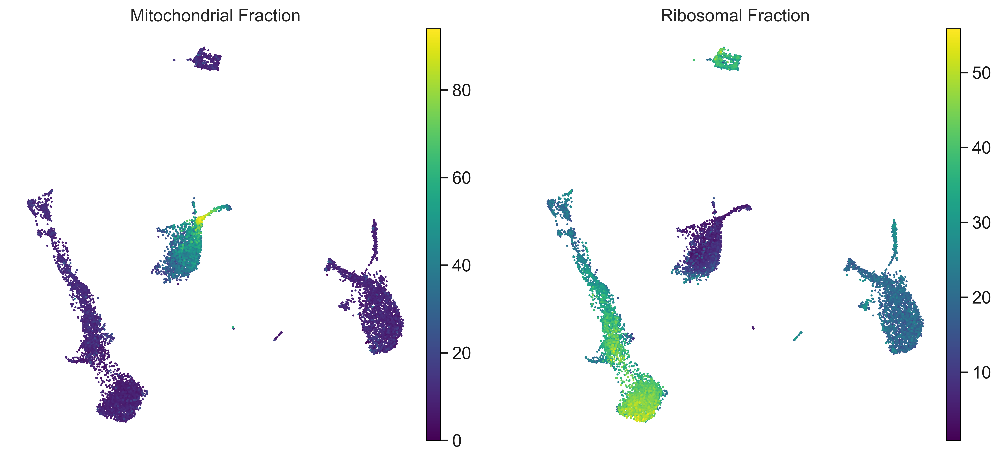

In [29]:
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=300)
sc.pl.umap(
    adata, 
    color=['pct_counts_mito', 'pct_counts_ribo'],
    title = ['Mitochondrial Fraction', 'Ribosomal Fraction'],
    cmap='viridis', 
    frameon=False,
)

## First 4 PCs

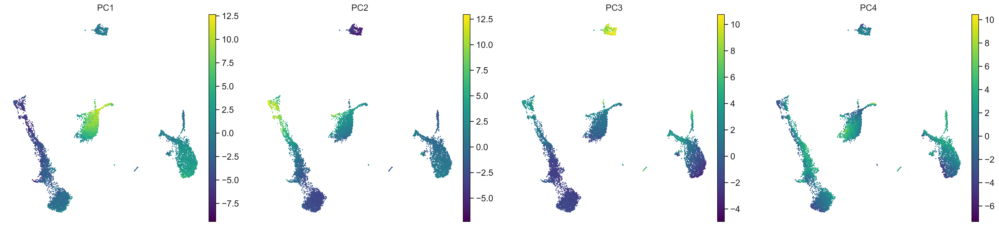

In [30]:
pc_names = []

for x in range(1, 5):
    pc = adata.obsm['X_pca'][:, x]
    adata.obs['PC' + str(x)] = pc
    
    pc_names.append('PC' + str(x))

sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=300)
sc.pl.umap(
    adata, 
    color=pc_names,
    show=True,
    cmap='viridis', 
    frameon=False,
)

# Clusters

## UMAP

In [31]:
phenograph_palette = gen_palette(adata, 'PhenoGraph_clusters')

<AxesSubplot:title={'center':'PhenoGraph Clusters'}, xlabel='UMAP1', ylabel='UMAP2'>

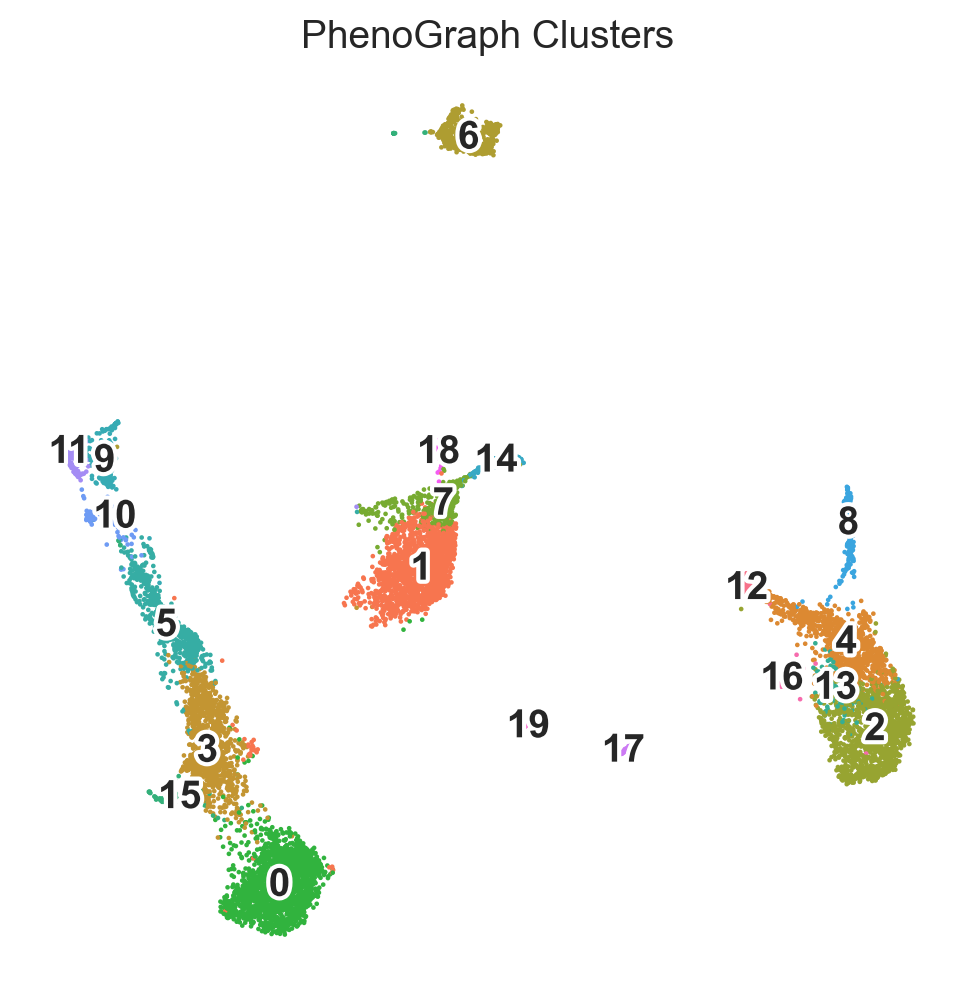

In [32]:
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=100)
sc.pl.umap(
    adata, 
    color=['PhenoGraph_clusters'],
    title = 'PhenoGraph Clusters',
    frameon=False,
    show=False,
    legend_loc='on data',
    legend_fontsize=14,
    legend_fontoutline=3,
    palette=phenograph_palette
)

<AxesSubplot:title={'center':'PhenoGraph Clusters'}, xlabel='UMAP1', ylabel='UMAP2'>

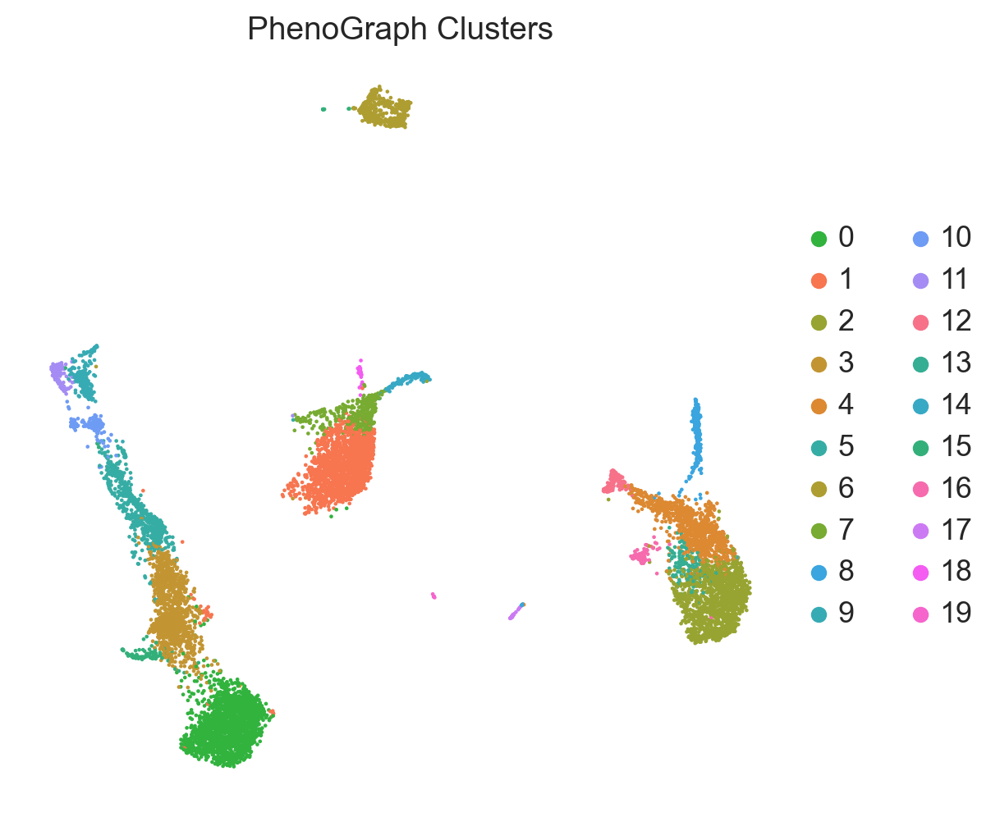

In [33]:
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=100)
sc.pl.umap(
    adata, 
    color=['PhenoGraph_clusters'],
    title = 'PhenoGraph Clusters',
    frameon=False,
    show=False,
    palette=phenograph_palette
)

## Num cells per cluster

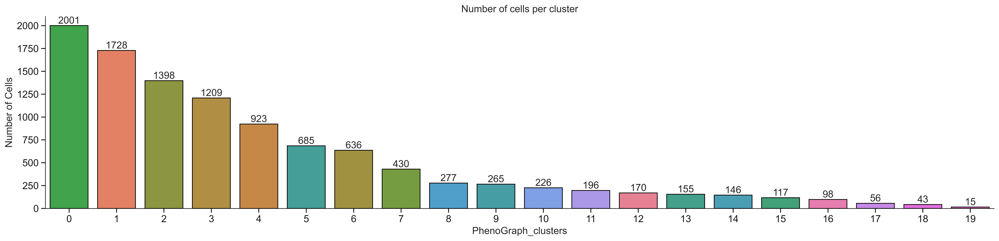

In [34]:
sns.set_style({'axes.grid' : False})
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)
plot_num_cells(adata=adata, 
               obs_col='PhenoGraph_clusters', 
               ax=ax, 
               palette=phenograph_palette
              )
ax.set(title='Number of cells per cluster')
fig.tight_layout()

## Proportion of cells in each cluster per sample

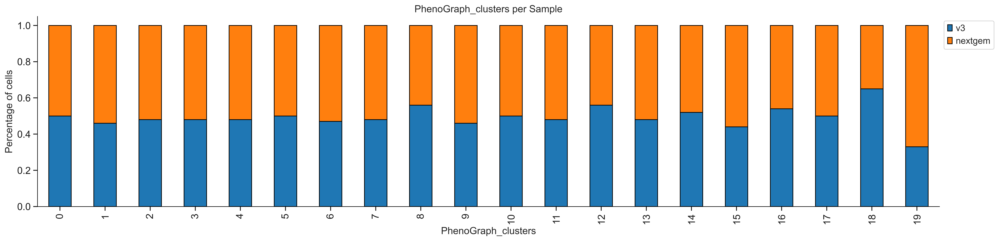

In [35]:
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)
plot_prop_cells_per_sample(adata, obs_col = 'PhenoGraph_clusters', 
                           ax=ax, palette = sample_palette_d)
fig.tight_layout()

# Top ranked genes per PhenoGraph cluster

In [36]:
sc.tl.rank_genes_groups(adata, 'PhenoGraph_clusters', method='wilcoxon')

# Style
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=300)
sns.set_style({'axes.grid' : False})

sc.pl.rank_genes_groups(adata, n_genes=30)

In [37]:
cluster = '0'
sc.get.rank_genes_groups_df(adata, cluster)

,names,scores,logfoldchanges,pvals,pvals_adj
0,RPS3A,64.594879,1.855753,0.0,0.0
1,RPL32,63.878330,1.837901,0.0,0.0
2,RPL30,63.508347,1.804274,0.0,0.0
3,RPS6,63.235741,1.872724,0.0,0.0
4,RPL11,62.397415,1.565473,0.0,0.0
...,...,...,...,...,...
16790,S100A4,-37.750134,-2.651593,0.0,0.0
16791,NEAT1,-38.512989,-2.282358,0.0,0.0
16792,AHNAK,-39.256966,-2.980603,0.0,0.0
16793,MT-CO2,-39.392059,-0.935945,0.0,0.0


# Quality of cluster

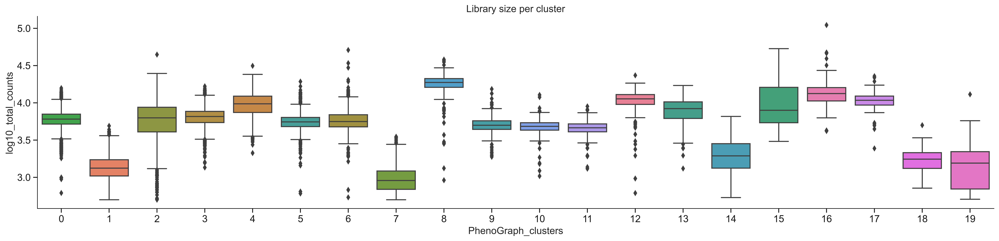

In [38]:
sns.set_style({'axes.grid' : False})
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)
plot_boxplot_cluster(adata, groupby = 'PhenoGraph_clusters', 
                     obs_col = 'log10_total_counts', palette = phenograph_palette,
                    ax=ax)
ax.set(title='Library size per cluster')
fig.tight_layout()

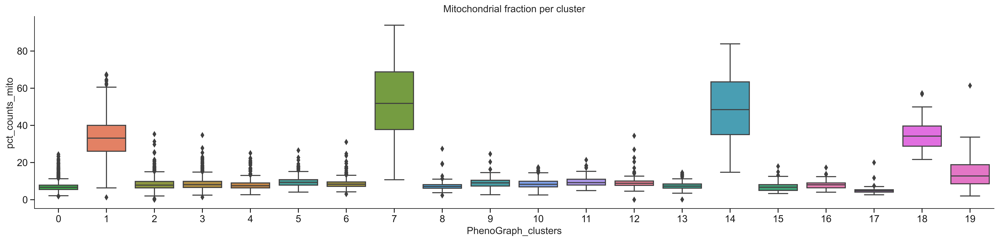

In [39]:
sns.set_style({'axes.grid' : False})
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)
plot_boxplot_cluster(adata, groupby = 'PhenoGraph_clusters', 
                     obs_col = 'pct_counts_mito', palette = phenograph_palette,
                    ax=ax)
ax.set(title='Mitochondrial fraction per cluster')

fig.tight_layout()

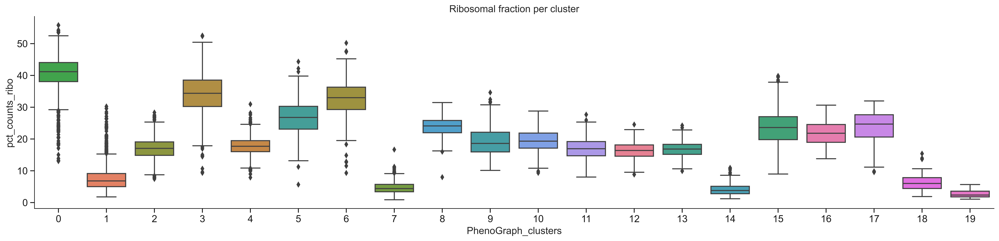

In [40]:
sns.set_style({'axes.grid' : False})
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)
plot_boxplot_cluster(adata, groupby = 'PhenoGraph_clusters', 
                     obs_col = 'pct_counts_ribo', palette = phenograph_palette,
                    ax=ax)
ax.set(title='Ribosomal fraction per cluster')

fig.tight_layout()

# Top ranked genes per sample

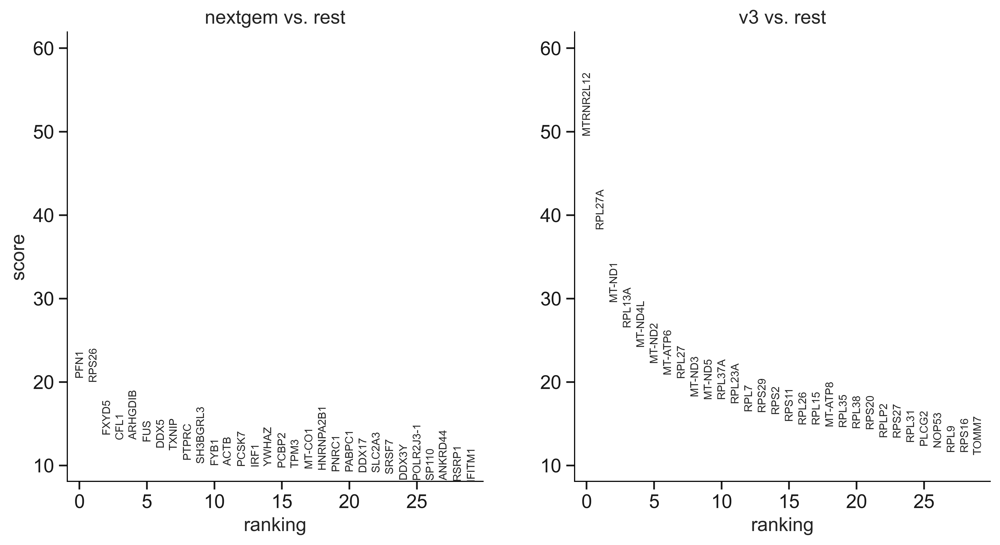

In [42]:
sc.tl.rank_genes_groups(adata, 'Sample', method='wilcoxon')

# Style
sc.set_figure_params(facecolor='white', figsize=(6, 6), dpi=300)
sns.set_style({'axes.grid' : False})

sc.pl.rank_genes_groups(adata, n_genes=30)

# Save

In [41]:
adata.write_h5ad('../adata/pass_00_qc.h5ad')